# Style Transfer with Deep Neural Networks


In this notebook, we’ll *recreate* a style transfer method that is outlined in the paper, [Image Style Transfer Using Convolutional Neural Networks, by Gatys](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf) in PyTorch.


In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch

In [2]:
torch.cuda.empty_cache()

In [3]:
from src.StyleTransfer import StyleTransfer


In [4]:
# content_image = 'images/octopus.jpg'
content_image = 'images/GodStatute_GrandPalace_Bangkok.jpg'

# style_image='images/hockney.jpg'
style_image='images/mah_tip.jpg'

In [5]:
# from src.StyleTransfer import StyleTransfer

st = StyleTransfer(content_image=content_image, style_image=style_image)

In [6]:
st.device

'cuda'

In [7]:
st.vgg

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [8]:
st.layer_mapping

{'0': 'conv1_1',
 '5': 'conv2_1',
 '10': 'conv3_1',
 '19': 'conv4_1',
 '21': 'conv4_2',
 '28': 'conv5_1'}

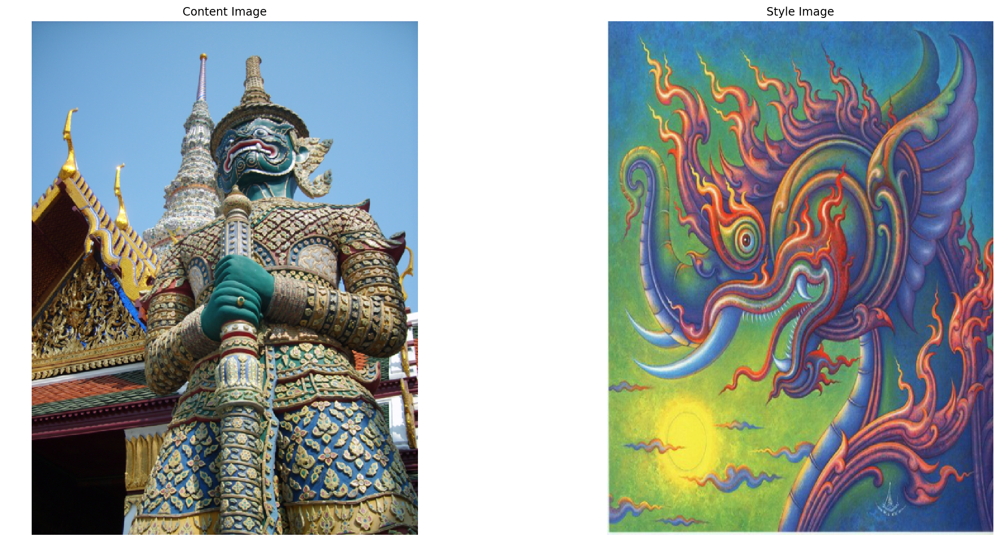

In [11]:
st.showInputImages()

In [12]:
st.vgg

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

**************************
***** Start generating the Target image *****
Learning Rate: 0.003
Number of learning iterations: 2000
**************************
*** [2019-09-01 21:05:50] Steps#400 - Total loss: 36088060.0


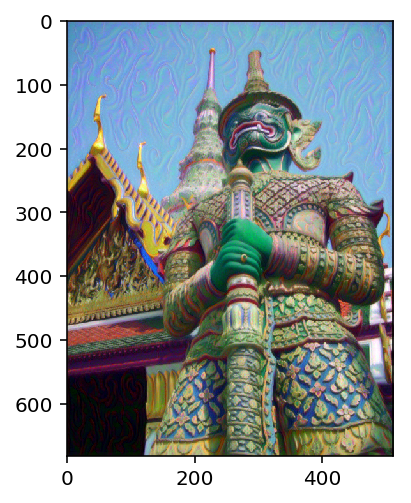

*** [2019-09-01 21:06:16] Steps#800 - Total loss: 13102401.0


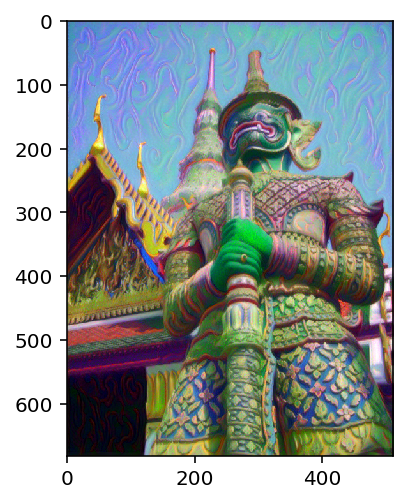

*** [2019-09-01 21:06:43] Steps#1200 - Total loss: 7636558.5


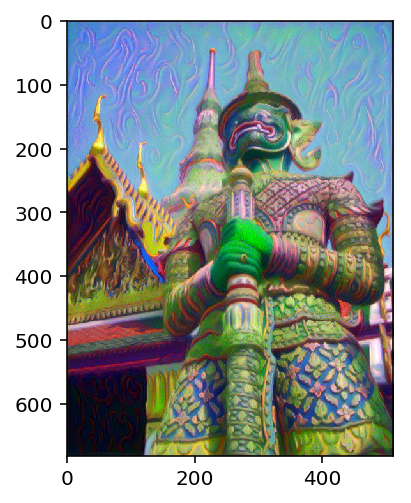

*** [2019-09-01 21:07:10] Steps#1600 - Total loss: 5005982.5


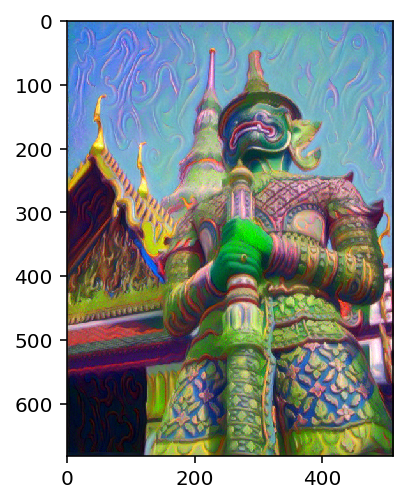

*** [2019-09-01 21:07:37] Steps#2000 - Total loss: 3481505.5


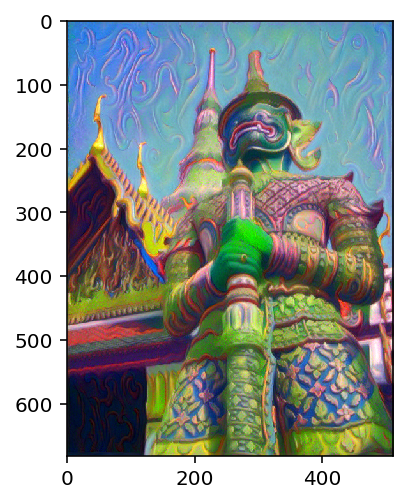

In [20]:
st.generate_target_image()

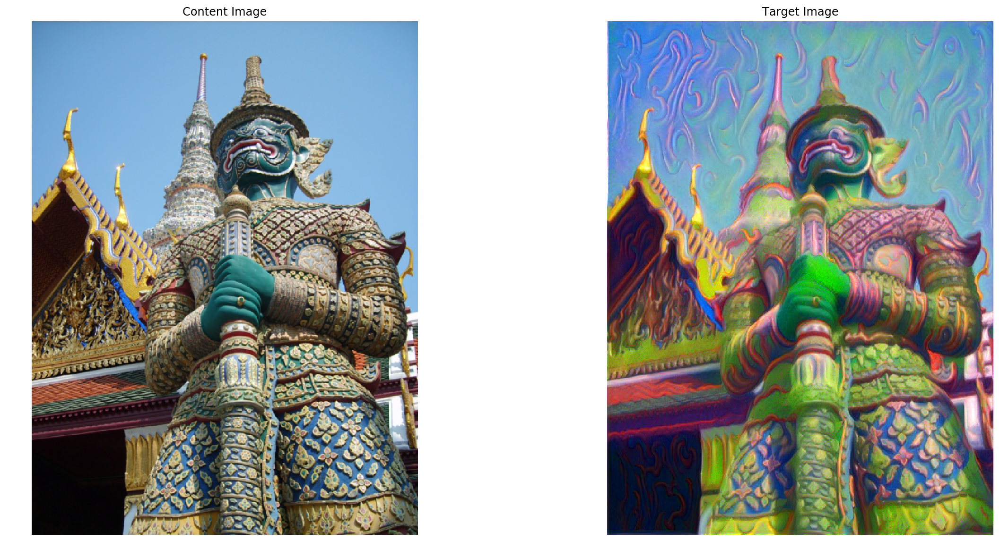

In [21]:
st.showTargetImage()

In [22]:
st.export_target_image(output_path='output_2000.png')

*** Target image has been saved to "output_2000.png"


**************************
***** Start generating the Target image *****
Learning Rate: 0.003
Number of learning iterations: 2000
**************************
*** [2019-09-01 21:09:43] Steps#400 - Total loss: 1074300.5


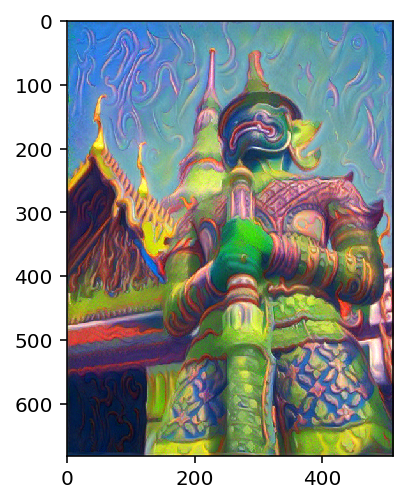

*** [2019-09-01 21:10:11] Steps#800 - Total loss: 536168.75


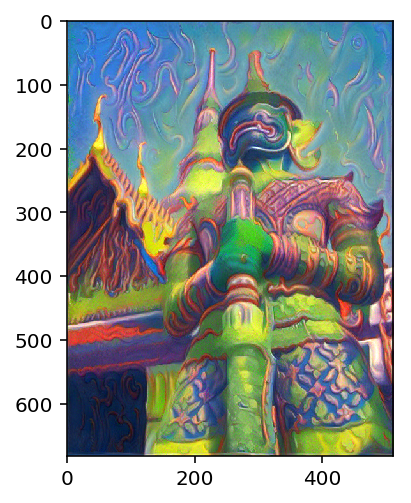

*** [2019-09-01 21:10:38] Steps#1200 - Total loss: 355193.0625


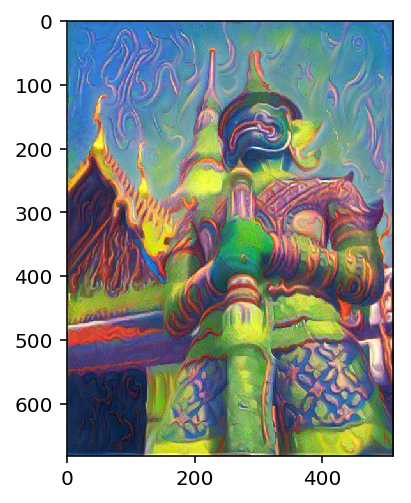

*** [2019-09-01 21:11:05] Steps#1600 - Total loss: 268669.3125


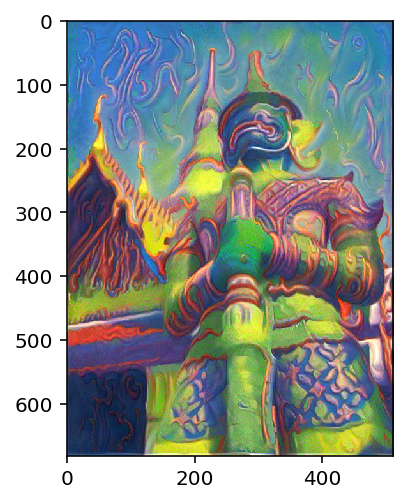

*** [2019-09-01 21:11:33] Steps#2000 - Total loss: 218583.828125


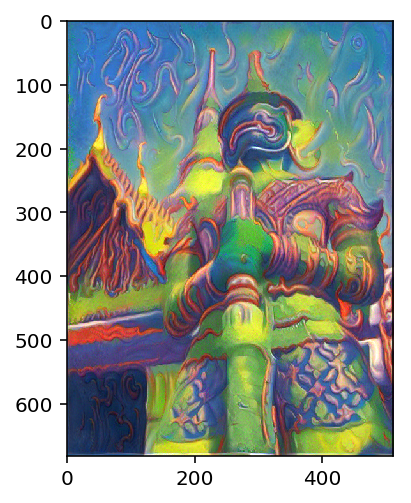

In [23]:
# Train for another 2000 (Total is 6000)
st.generate_target_image()

In [24]:
st.export_target_image(output_path='output_4000.png')

*** Target image has been saved to "output_4000.png"


In [25]:
st_2 = StyleTransfer(content_image='images/GrandPalace_Bangkok.jpg', style_image=style_image)

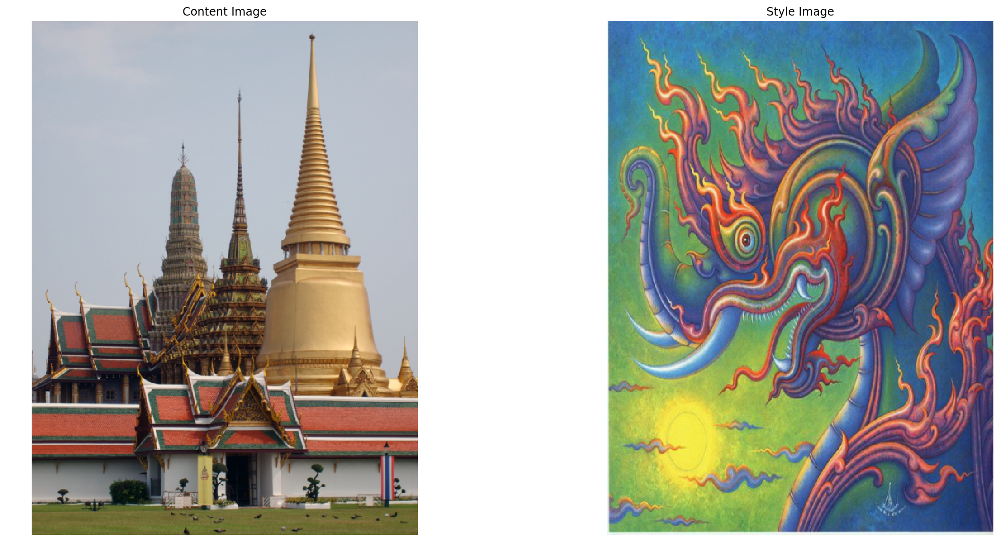

In [26]:
st_2.showInputImages()

**************************
***** Start generating the Target image *****
Learning Rate: 0.003
Number of learning iterations: 4000
**************************
*** [2019-09-01 21:19:53] Steps#400 - Total loss: 203529.046875


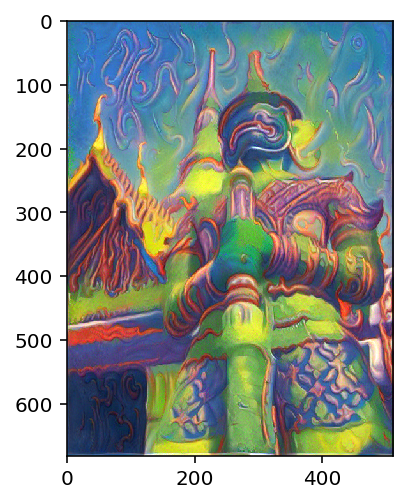

*** [2019-09-01 21:20:20] Steps#800 - Total loss: 184164.125


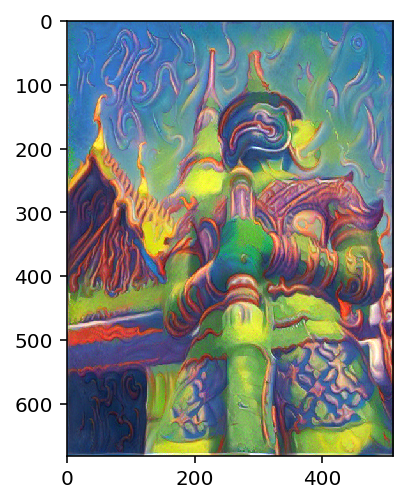

*** [2019-09-01 21:20:47] Steps#1200 - Total loss: 166993.28125


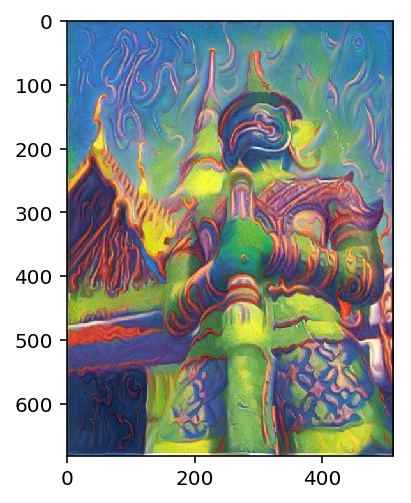

*** [2019-09-01 21:21:14] Steps#1600 - Total loss: 152800.703125


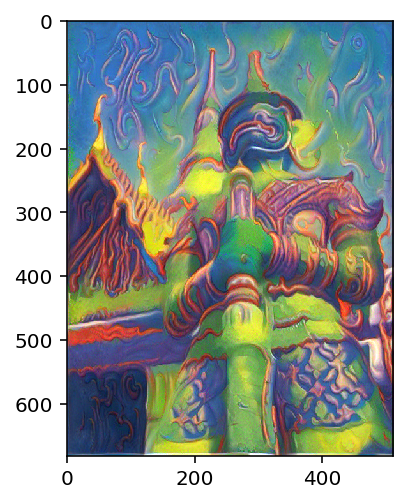

*** [2019-09-01 21:21:41] Steps#2000 - Total loss: 141989.34375


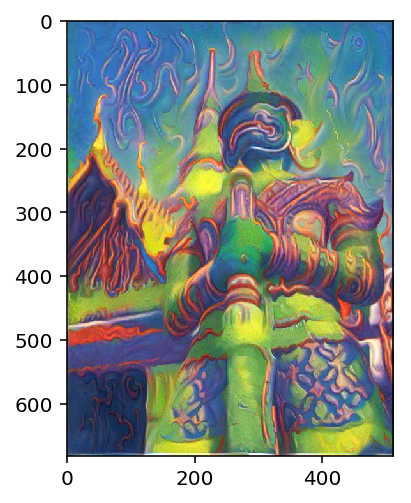

*** [2019-09-01 21:22:09] Steps#2400 - Total loss: 134601.828125


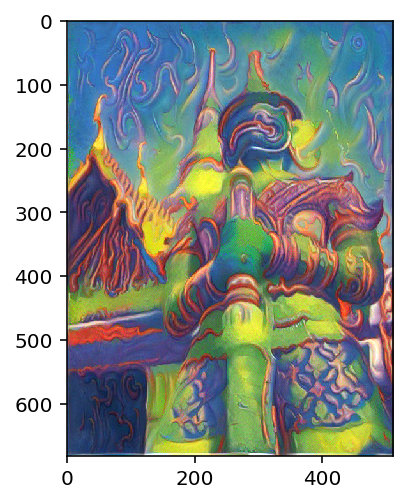

*** [2019-09-01 21:22:37] Steps#2800 - Total loss: 126287.21875


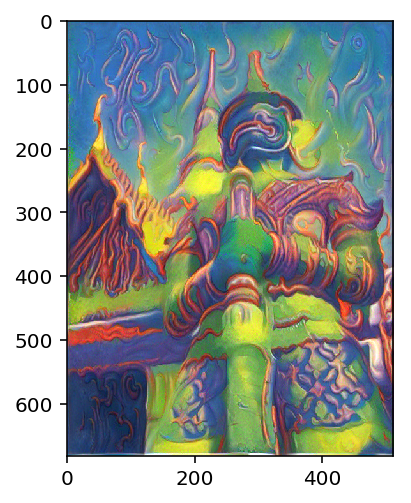

*** [2019-09-01 21:23:04] Steps#3200 - Total loss: 119958.2109375


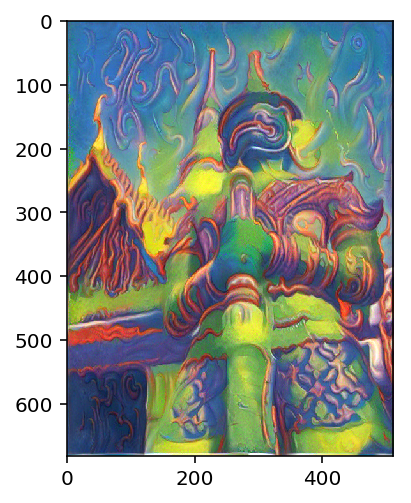

*** [2019-09-01 21:23:32] Steps#3600 - Total loss: 115558.5078125


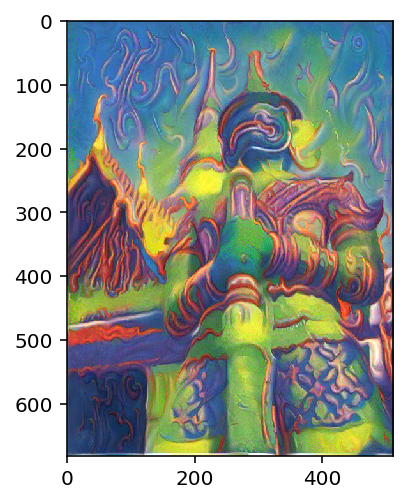

*** [2019-09-01 21:24:00] Steps#4000 - Total loss: 112477.6796875


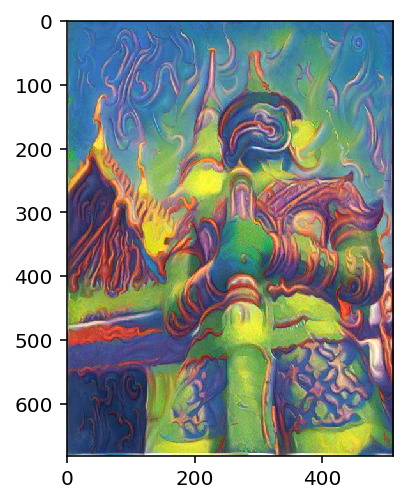

In [27]:
st.generate_target_image(steps=4000)

In [28]:
st.export_target_image(output_path='output_8000.png')

*** Target image has been saved to "output_8000.png"


**************************
***** Start generating the Target image *****
Learning Rate: 0.003
Number of learning iterations: 5000
**************************
*** [2019-09-01 21:26:21] Steps#400 - Total loss: 50441760.0


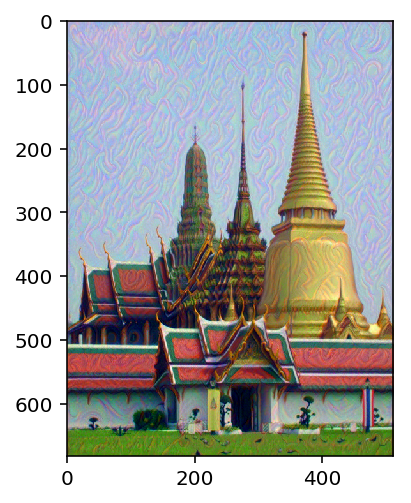

*** [2019-09-01 21:26:49] Steps#800 - Total loss: 18196194.0


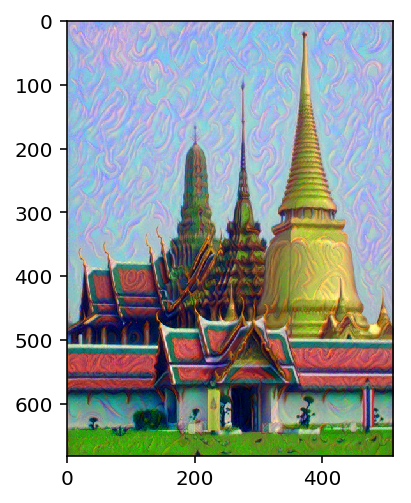

*** [2019-09-01 21:27:16] Steps#1200 - Total loss: 11287264.0


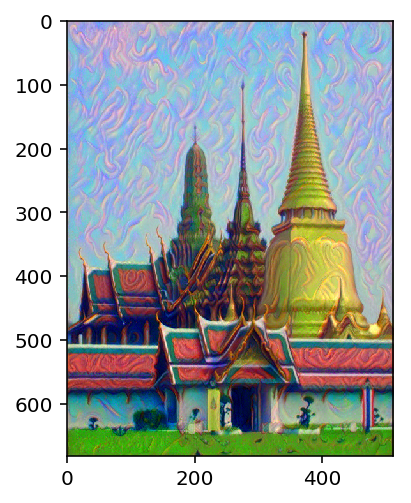

*** [2019-09-01 21:27:44] Steps#1600 - Total loss: 7141302.5


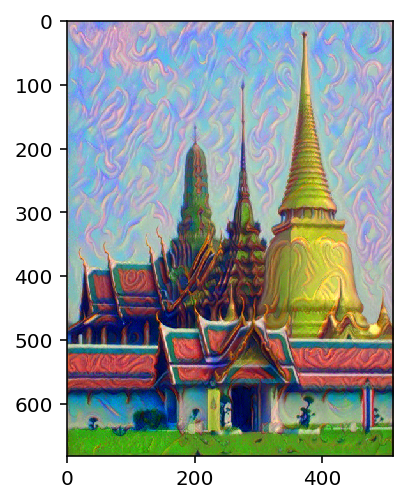

*** [2019-09-01 21:28:12] Steps#2000 - Total loss: 4749048.5


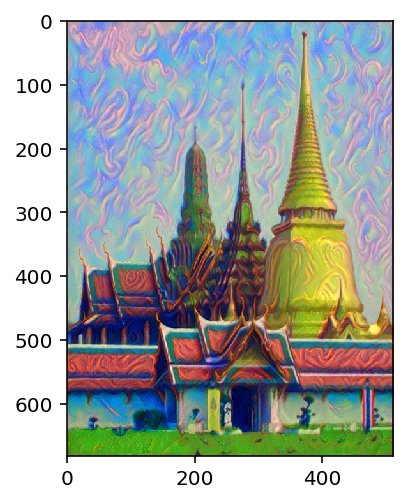

*** [2019-09-01 21:28:41] Steps#2400 - Total loss: 3394144.0


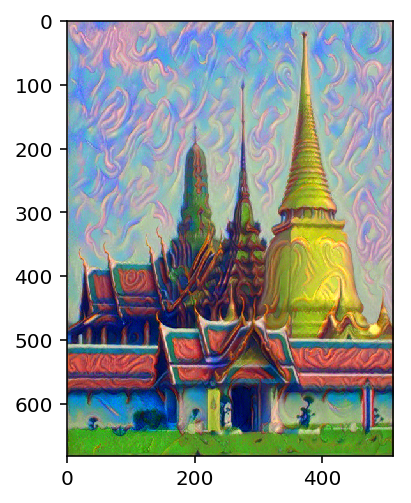

*** [2019-09-01 21:29:09] Steps#2800 - Total loss: 2541490.5


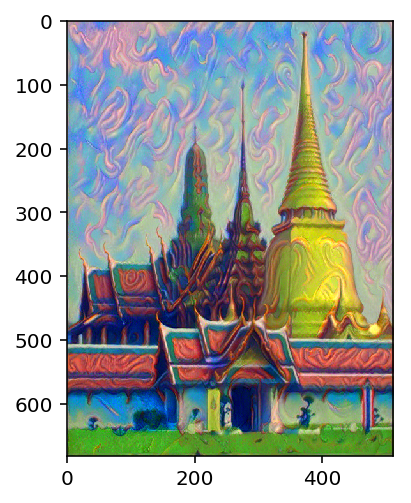

*** [2019-09-01 21:29:36] Steps#3200 - Total loss: 1951323.625


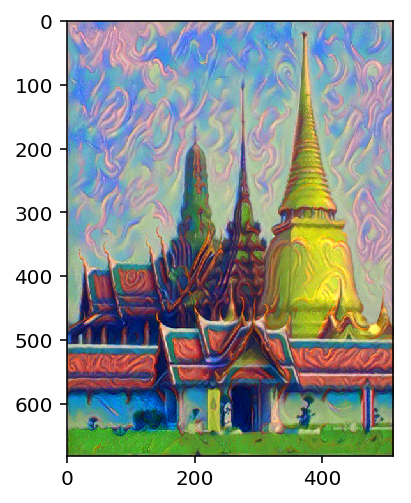

*** [2019-09-01 21:30:04] Steps#3600 - Total loss: 1523585.625


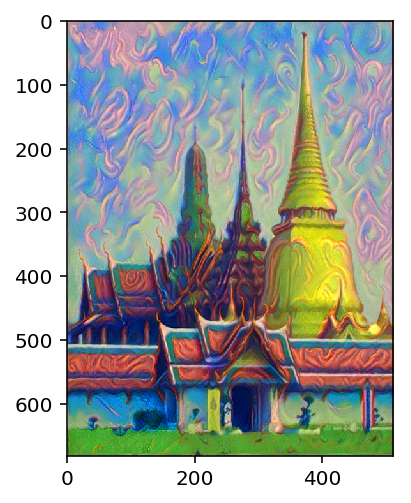

*** [2019-09-01 21:30:32] Steps#4000 - Total loss: 1206882.875


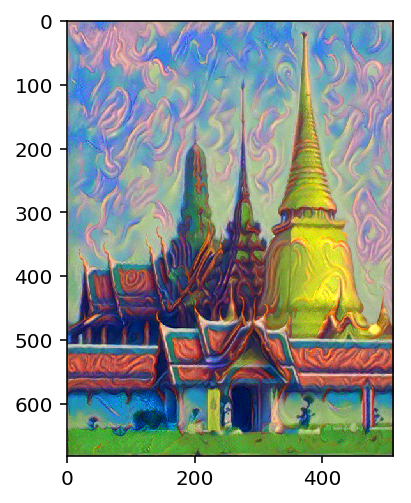

*** [2019-09-01 21:31:00] Steps#4400 - Total loss: 967989.0625


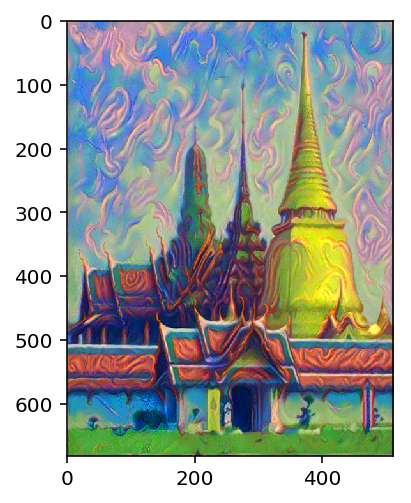

*** [2019-09-01 21:31:28] Steps#4800 - Total loss: 784836.125


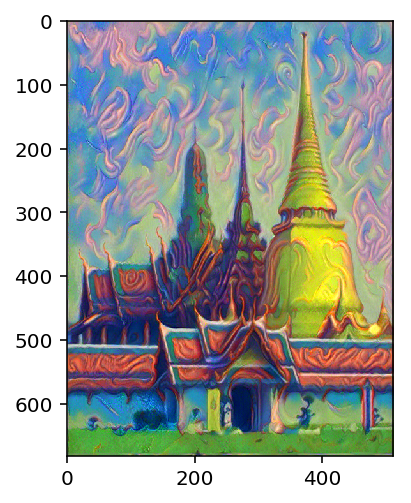

In [29]:
st_2.generate_target_image(steps=5000)

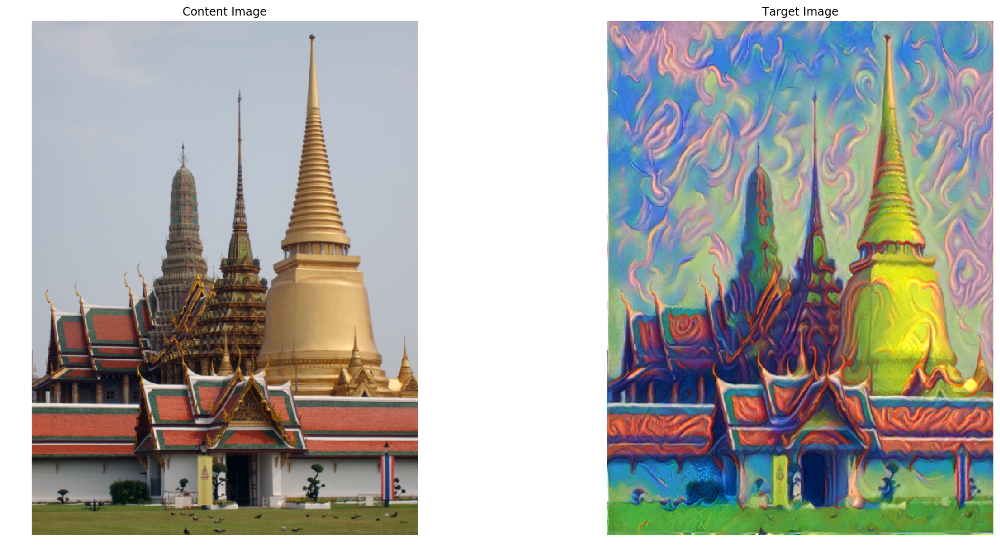

In [31]:
st_2.showTargetImage()

In [32]:
st_2.export_target_image(output_path="output_GrandPalace_5000")

*** Target image has been saved to "output_GrandPalace_5000"
